# Introduction to Data Science and Systems 2020-2021<small><small>v20202021a</small></small>
## Lab 3: Introduction to Probability
#### - ***you should submit this notebook on Moodle along with one pdf file (see the end of the notebook and Moodle for instructions)***
---
#### University of Glasgow,  JHW (amended by BSJ and NP) 2021


$$
\newcommand{\vec}[1]{ {\bf #1}} 
\newcommand{\real}{\mathbb{R}}
\DeclareMathOperator*{\argmin}{arg\,min}
\newcommand{\expect}[1]{\mathbb{E}[#1]}
$$

## Purpose of this lab

This lab should help you:    
* understand basic probability including probability mass functions and probability density functions
* understand how to manipulate marginal, joint and conditional distributions
* understand Bayes' rule
* understand the multivariate normal distribution
* understand how optimisation can be used to estimate parameters in a simple statistical model using maximum likelihood estimation


## Guide

Lab 3 is structured as follows (with two main task sections):

>- Part 1: Probability with discrete random variables
>- Part 2: Probability with continuous random variables

We recommend you read through the lab *carefully* and work through the tasks.

#### Material and resources 
- It is recommended to keep the lecture notes (from lectures 7 & 8 in particular) open while doing this lab exercise. 
    * ... and you should, of course, be prepared to access some of the recommended material.
- If you are stuck, the following resources are very helpful:
 * [NumPy cheatsheet](https://github.com/juliangaal/python-cheat-sheet/blob/master/NumPy/NumPy.md)
 * [NumPy API reference](https://docs.scipy.org/doc/numpy-1.13.0/reference/)
 * [NumPy user guide](https://docs.scipy.org/doc/numpy-1.13.0/user/basics.html)

#### Marking and Feedback
*Note*: This lab is marked out of 80 but accounts for the same overall percentage as the other labs.

This assessed lab is marked using three different techniques;

- Autograded with feedback; you'll get immediate feedback.
- Autograded without (immediate) feedback (there will always be a small demo/test so you can be confident that the format of your answer is correct).

*Note*: auto-graded results are always provisional and subject to change in case there are significant issues (this will usually be in favour of the student).

#### Help \& Assistance
- This lab is graded and the lab assistants/lecturer can provide guidance, but we can (and will) not give you the final answer or confirm your result.

#### Plagiarism
- All submissions will be automatically compared against each other to make sure your submission represents an independent piece of work! We have provided a few checks to make sure that is indeed the case.


---

# Before you begin

Please update the tools we use for the automated greading by running the below command (uncomment) and restart your kernel (and then uncomment again) -- or simply perform the installation externally in an Anaconda/Python prompt.

In [1]:
#!pip install -U --force-reinstall --no-cache https://github.com/johnhw/jhwutils/zipball/master

Import the basics...

In [2]:
# Standard imports
# Make sure you run this cell!
from __future__ import print_function, division
import numpy as np  # NumPy
import scipy.stats 
import os
import sys
import binascii
from unittest.mock import patch
from uuid import getnode as get_mac

from jhwutils.checkarr import array_hash, check_hash, check_scalar, check_string
import jhwutils.image_audio as ia
import jhwutils.tick as tick

###
tick.reset_marks()

# special hash funciton
def case_crc(s, verbose=True):
    h_crc = binascii.crc32(bytes(s.lower(), 'ascii'))
    if verbose:
        print(h_crc)
    return h_crc

# this command generaties a unique key for your system/computer/account
uuid_simple = (("%s") % get_mac())
uuid_str = ("%s\n%s\n%s\n%s\n%s\n") % (os.path,sys.path,sys.version,sys.version_info,get_mac())
uuid_system = case_crc(uuid_str,verbose=False) 


# Set up Matplotlib
import matplotlib as mpl   
import matplotlib.pyplot as plt
%matplotlib inline
plt.rc('figure', figsize=(8.0, 4.0), dpi=140)
np.random.seed(2019)

# You can ignore this
import lzma, base64
exec(lzma.decompress(base64.b64decode(b'/Td6WFoAAATm1rRGAgAhARYAAAB0L+Wj4AuQBIRdADSbSme4Ujxz95HdWLf4m39SX9b5yuqRd8UVk3DwULgMdEb8P1bLvis2Swz3hlDU+FwGvQQSXUZEv0GMy+ErARv0E4TRCmTvFyQ5JSb/G7uf1mJI1cRyyqS/p8OjxfizueERZipJkqifEM7mgPLl2o+B4OX/p+0Vu3LfTMRZvY//6V0JXZwRxDGVuddVdlsZOuNDNEzsXiiyo2fiXL31w0sXabfigUkJ4q1uo4W7C0THX7Lhb0zVk9A0/+f114CeChR9Gz25xOstbGjOodl1SDpP5rKIxkxZTzcjw65yJRKqid46CTa5ffWK7y9QtygL7IqcGB9ode3TKcTh57Edd9+wylW9BiSE8/qh/93qFavlXK1sjLdoTWEfPZ96HOR6La9g8KEEFNNMAc+7HtTv1JwoX8w+zLayLzdpIqA+HLAVFiVeFg4jPu8imDtmoOhe66WDgPWsXetR6FFCK7mw4q4Q+A4TCz6ugUoh/gIEGjIadianBQVSST062b8vSLzWmFYLKJoRPDHPyvFWKX5u27LZ9Bpswls2feqW6SBEvavwjckRwW5r4Fc6F+MEYgZmAUy8sJRXe7JHvp6LZ3o5RM92eQRoGsDeL82U2LC6sXfxy3MBj6Gd0wwWC9iJdyvs+laSdI41jk2lZUcDpVCBoSV/Zr+0rH1PsT33u2NlfDsaXrG67zKhbB+SSGz3OoN6Kq/1GwWf+GvNH3cySyrJOgN2edwh/fn87XMHk5QZCg0BtZRObATtZAoloB5jJGvjwqtxHCItkTdGoUi4TY75N3FMTPowFYUXn2tjAtngJibqtGbZ/+PaS7E134Lsvxy5o2uaBgoV+U9Mg1poz1QAl0YTKDNMZjVILDbKIRq9e2C4X6e3SWQRW4LrBujBJp7Q8AJjKIspFOLt7PzxOwkSHES90iNgMW4Sn+uTKwQEcTrtTZCDm5Bynn5taepEXp2hj2cmuZEGJCXX8HOM9RgnWyeOVDcUPRCGAGrjA3y7VZGuEjdPE4DT32dmqJabHrPtrc0tgde5UfefS8ezzGOEheOmYQEtpIZLY2TwuNbhOIvIxNfnDA7H7ug1LtCSTejYkGU9CztGzKkyoWEMSTGQSd7aEddrdDS8gsOF6r+RmhCutjGejXFHFtVEcL8FJxczfLdbWDNdBl69IrZ8vlV6Ts4FojBO0/w6HAv24jyX1r+4n3ymPeJZb2SR7HQ/4L2In4ywuUdCkI2t2UuB0fHYgA+ibCVPoXg5Da698PlcozIlD/cmP+3OAnEU+yPElHmLrfjGLFwmWN28ikbluPx0be9B7sn4qTJUY0zrOBuv+wS47A7j5XXicpakCHJcqDaEuzWCa6e1JRmIDoitnr+2kNbGDYNPgKKJE8XDvWVZTgnG1NCGhTZJlTL37hZZIuwkA5RbpnOlrEldKjGnol9D209OuritES1GvlL2H7lDtRTiMnHPHcHMnVqPg5usk3F2Zw23PtC1YDaHvqxgyqaXlRslElFtLz2k9GV2QC3bUxVVlf6jQgPkDoQhKu63JjQtoPRrn0AAR37PsnsFZ74AAaAJkRcAAHaUzMuxxGf7AgAAAAAEWVo=')).decode('ascii'))
print("Everything imported OK (ignore deprecated warnings)")

C:\Users\zjcar\anaconda3\lib\site-packages\IPython\kernel\__init__.py:12: ShimWarning: The `IPython.kernel` package has been deprecated since IPython 4.0.You should import from ipykernel or jupyter_client instead.
  warn("The `IPython.kernel` package has been deprecated since IPython 4.0."
Everything imported OK (ignore deprecated warnings)


In [3]:
# Hidden cell for utils needed when grading (you can/should not edit this)

---

**Mini-task**: provide your personal details in two variables:

* `student_id` : a string containing your student id (e.g. "1234567x"), must be 8 chars long.
* `student_typewritten_signature`: a string with your name (e.g. "Adam Smith") which serves as a declaration that this is your own work (read the declaration of originality when you submit on Moodle).

In [4]:
# YOUR CODE HERE
student_id = "2527873Z" # your 8 char student id
student_typewritten_signature = "Jichen Zhao" # your full name, avoid spceical chars if possible

---

## Part 1. Hunt the submarine - gridworld version

The USS Scorpion has been lost at sea. Your job is to model where it might be probabilistically. 

<img src="imgs/scorpion.jpg" width="50%">

In part 1 of this lab, we will assume that our world is divided into a 2D grid of squares, each of which might contain an errant submarine.

<img src="imgs/sea_grid.png" width="50%">

### Part 1 Random variables, outcomes and events

We assume that the submarine's location is given by a random variable $X$ whose sample space is the space of 2D grid points $\vec{x}=[x,y]$ where $x$ and $y$ are integers in the range 0-15 (inclusive). (Be careful: the `x,y` order is the opposite of the `row, column` format used in images).

You are given a probability mass function as a 16x16 matrix `submarine_pmf` giving the probability of each grid square, i.e $f_X(\vec{x}) = P(X=\vec{x})$. 


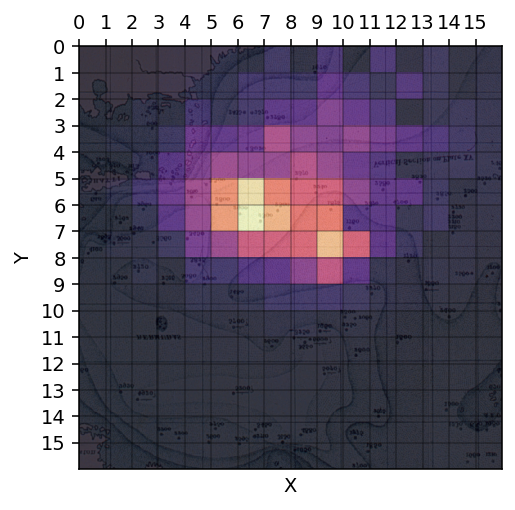

In [5]:
show_pmf(submarine_pmf) # show the PMF on top of a map

### Outcomes and events
Compute the the following values, all of which are scalars. The notation [x1, y1] -> [x2, y2] indicates a box that should **include** `x1,y1,x2,y2` (be careful!).

* `in_1_4` probability submarine is in square [1,4]
* `out_3_3` probability submarine is *not* in square [3,3]
* `west_6` submarine is in square [x<=6, y]
* `y_div_3` submarine has a y coordinate exactly divisible by 3
* `below_above` submarine is in square [x, y<10] or [x, y>=13]
* `box_1` submarine is in the box [1, 4] -> [3, 9] (inclusive!)
* `box_2` submarine is in the box [0, 0] -> [15, 15] (inclusive!)
* `evens` submarine has x>=8 and an even y coordinate
* `odds_not_box` the *odds* that the submarine is *not* in the box [0, 5] -> [5,10]
* `odds_even` the *odds* that the submarine has an x coordinate which is even
* `logit_3_7` the log-odds (logits) that the submarine is in square [3, 7]
* `dlogit_box` the *change* in log-odds from the hypothesis that the submarine is in the box [0,5] -> [5, 10] to being in the box [1,1] -> [5,5]



In [6]:
# YOUR CODE HERE
in_1_4 = submarine_pmf[1, 4]
out_3_3 = 1 - submarine_pmf[3, 3]
west_6 = np.sum(submarine_pmf[:7])
y_div_3 = np.sum(submarine_pmf[:, ::3])
below_above = np.sum(np.hstack((submarine_pmf[:, :10], submarine_pmf[:, 13:])))
box_1 = np.sum(submarine_pmf[1:4, 4:10])
box_2 = np.sum(submarine_pmf[:16, :16])
evens = np.sum(submarine_pmf[8:, ::2])

not_box = 1 - np.sum(submarine_pmf[:6, 5: 11])
odds_not_box = (1 - not_box) / not_box  # odds = (1 - probability) / probability

x_even = np.sum(submarine_pmf[::2])
odds_even = (1 - x_even) / x_even

in_3_7 = submarine_pmf[3, 7]
logit_3_7 = np.log(in_3_7 / (1 - in_3_7))  # logit = log(1/odds)

hypothesis_1 = np.sum(submarine_pmf[:6, 5:11])
hypothesis_2 = np.sum(submarine_pmf[1:6, 1:6])
dlogit_box = np.log(hypothesis_1 / (1 - hypothesis_1)) - np.log(hypothesis_2 / (1 - hypothesis_2))

In [7]:
with tick.marks(1):
    assert check_scalar(in_1_4, '0xe7d4ba8d')

In [8]:
with tick.marks(1):
    assert check_scalar(out_3_3, '0x99c03236')

In [9]:
with tick.marks(1):
    assert check_scalar(west_6, '0x59f3b9f7')

In [10]:
with tick.marks(1):
    assert check_scalar(y_div_3, '0xdaa43a7a')

In [11]:
with tick.marks(1):
    assert check_scalar(below_above, '0x8ea462bf')

In [12]:
with tick.marks(1):
    assert check_scalar(box_1, '0x7db96774')

In [13]:
with tick.marks(1):
    assert check_scalar(box_2, '0xb44c37ea')

In [14]:
with tick.marks(1):
    assert check_scalar(evens, '0xe44a25c7')

In [15]:
with tick.marks(1):
    assert check_scalar(odds_not_box, '0x88193758')

In [16]:
## Hidden test checking odds_even [1 marks]

In [17]:
with tick.marks(1):
    assert check_scalar(logit_3_7, '0x3f1ff384')

In [18]:
# Hidden test checking dlogit_box [2 marks]

---

### Expected value
You need to plan for the search operation. There is a fixed search station at square x=6, y=6. Assume the Euclidean (L2) norm in measuring distances. The time in hours to search a grid square from the station is given by `time = distance**2 + 4*distance + 10`.  Compute:

* `expected_location` Expected value of the submarine location.
* `expected_distance` expected value of the distance of the submarine to this fixed station 
* `total_search_time` the **total** search time required to search the every square on the entire grid. Assume each search of a grid square has to restart from the station.
* `expected_search_time` expected search time of a random search starting at the station.

**REMEMBER**, in general $$E[f(X)] \neq f(E[X]).$$

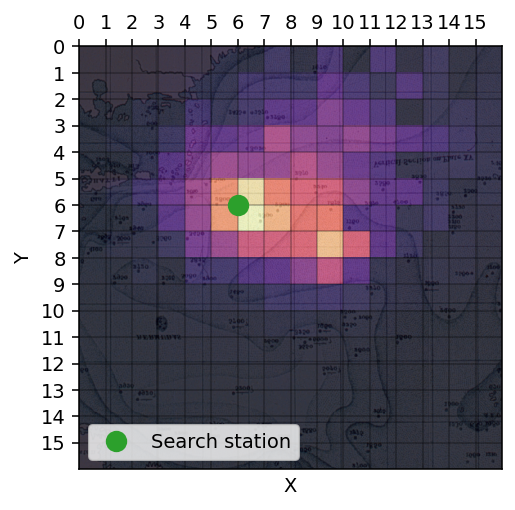

In [19]:
show_pmf(submarine_pmf)
plt.plot(6,6, 'C2o', label='Search station', markersize=10)
plt.legend(loc='lower left')

In [20]:
# YOUR CODE HERE
indices = np.arange(0, 16)
expected_location_x = np.sum(np.sum(submarine_pmf, axis = 1) * indices)
expected_location_y = np.sum(np.sum(submarine_pmf, axis = 0) * indices)
expected_location = [expected_location_x, expected_location_y]

distance = np.zeros((16, 16))

for i in range(16):
    for j in range(16):
        distance[i, j] = np.linalg.norm(np.array([i, j]) - np.array([6, 6]))

expected_distance = np.sum(submarine_pmf * distance)
time = distance ** 2 + 4 * distance + 10
total_search_time = np.sum(time)
expected_search_time = np.sum(submarine_pmf * time)

In [21]:
with tick.marks(2):
    assert check_scalar(expected_location[0], '0x4f9f5e7c')
    assert check_scalar(expected_location[1], '0x8805a495')

In [22]:
with tick.marks(2):
    assert check_scalar(expected_distance, '0x33d35673')

In [23]:
with tick.marks(2):
    assert check_scalar(total_search_time, '0xb1ca4255')

In [24]:
# Hidden test checking expected_search_time [3 marks]

---

### Part 1.3 Conditional probability
The search strategy could be improved if one of the $x$ or $y$ coordinates were known for sure (e.g. from another source, like satellite imaging). To identify how *much* this would help, we can use conditional probability distributions. Compute the following:


* `p_x_y` the *conditional* PMF of finding the submarine on an x coordinate given a y coordinate $P(X_x=x|X_y=y)$ as 16x16 matrix
* `p_y_x` the *conditional* PMF of finding the submarine on a y coordinate given an x coordinate $P(X_y=y|X_x=x)$ as 16x16 matrix
* `p_y_6` the conditional PMF of the submarine being in squares with y=6, as a single 16 element vector.
* `p_even_x` the PMF of the submarine being on a given y coordinate if we know the submarine is in a grid square with even x coordinate, as a single 16 element vector. $P(X_y=y|X_x = x, x\ \text{even})$
* `p_even_y_odd_x` the PMF of the submarine being on an even y coordinate if we know the submarine is in a grid square with odd x coordinate, as a single **8 element** vector. $P(X_y=y|X_x = x, x\ \text{odd}, y\ \text{even})$





In [25]:
# YOUR CODE HERE
p_x_y = submarine_pmf / np.sum(submarine_pmf, axis = 0)

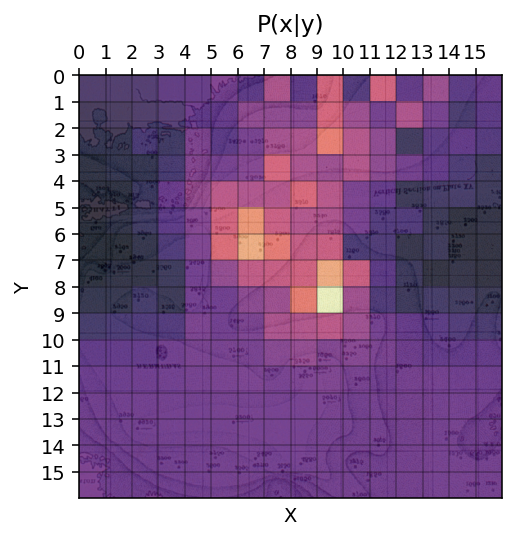

In [26]:
with tick.marks(2):    
    show_pmf(p_x_y, "P(x|y)")
    assert check_hash(p_x_y, ((16, 16), 2103.534977619737))

In [27]:
# YOUR CODE HERE
p_y_x = (submarine_pmf.T / np.sum(submarine_pmf, axis = 1)).T  # Transpose to normalise across columns, instead of rows.

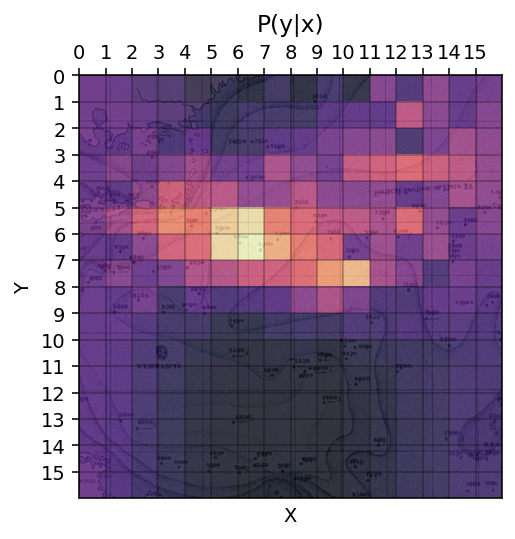

In [28]:
with tick.marks(2):
    show_pmf(p_y_x, "P(y|x)")
    assert check_hash(p_y_x, ((16, 16), 2031.7414411989753))

In [29]:
# YOUR CODE HERE
p_y_6 = submarine_pmf[:, 6] / np.sum(submarine_pmf[:, 6])

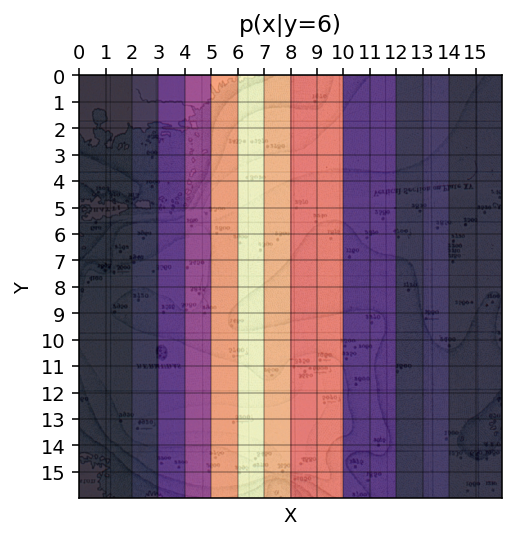

In [30]:
with tick.marks(2):
    show_pmf(p_y_6[:,None], 'p(x|y=6)')
    assert check_hash(p_y_6, ((16,), 8.36846919881838))    

In [31]:
# YOUR CODE HERE
p_even_x = np.sum(submarine_pmf[::2], axis = 0) / np.sum(submarine_pmf[::2])

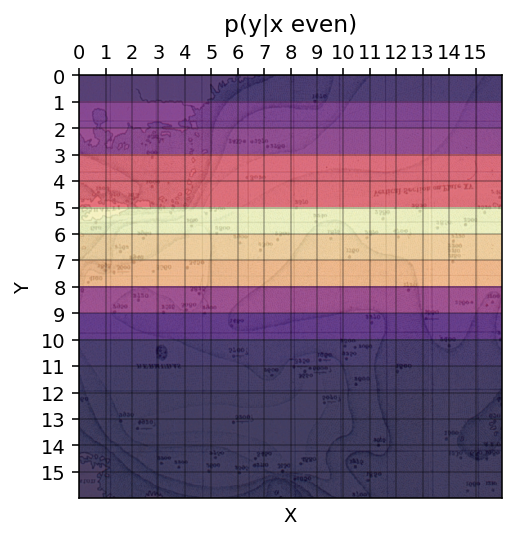

In [32]:
with tick.marks(2):
    show_pmf(p_even_x[None,:], 'p(y|x even)')
    assert check_hash(p_even_x, ((16,), 7.1624313253524745))

In [33]:
# YOUR CODE HERE
p_even_y_odd_x = np.sum(submarine_pmf[1::2, ::2], axis = 0) / np.sum(submarine_pmf[1::2, ::2])

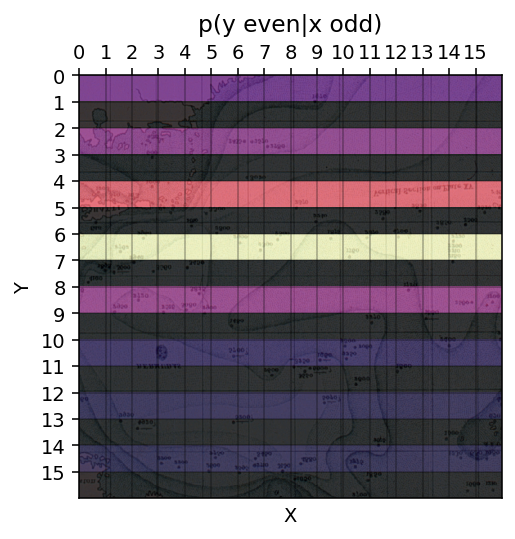

In [34]:
#Sanity check ; just to check size
with tick.marks(0):
    assert check_hash(0.0*p_even_y_odd_x, ((8,), 0.0))

tmp_pmf = np.stack([p_even_y_odd_x, 0*p_even_y_odd_x]).T.reshape(16,)    
show_pmf(tmp_pmf[None,:], 'p(y even|x odd)')

In [35]:
# Hidden test checking p_even_y_odd_x [3 marks]

---

### Entropy
The search could be guided more intelligently if we could work out how informative getting one of the coordinates could be. For example, knowing which `x` coordinate would give you *most* information about the `y` coordinate?  Compute the entropy of each conditional distribution $H(Y|X=n)$ and store it in `entropy_x`. Use base 2 for the entropy (i.e. bits).
Store the most useful `x` coordinate to know in `most_informative_x`.


In [36]:
# YOUR CODE HERE
entropy_x = np.sum(-p_y_x * np.log2(p_y_x), axis = 1)  # "p_y_x" is a conditional distribution computed in a previous block.
most_informative_x = np.argmin(entropy_x)  # The minimum entropy can represent the least surprise which also means the most information.

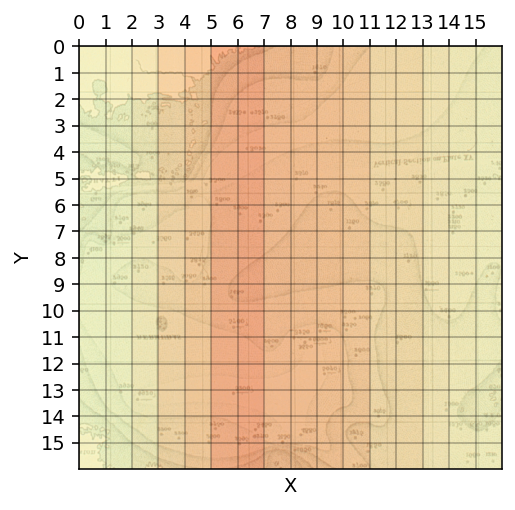

In [37]:
with tick.marks(5):
    show_pmf(entropy_x[:, None])
    assert check_hash(entropy_x, ((16,), 509.16360658756037))

In [38]:
#Sanity check; just to check size
with tick.marks(0):
    assert check_hash(0.0*most_informative_x, ((), 0.0 ))

In [39]:
# Hidden test checking most_informative_x [5 marks]

---

### Part 1.4 Validating pmfs

`submarine_pmf` is one possible model of the submarine location. A number of others have been proposed for this 16x16 gridworld model of searching by the scientific reserach team; but some of them are implemented incorrectly and are not valid PMFs. These probability mass functions are stored in a list of matrices 16x16 `proposed_pmfs`. Identify which of these PMFs are *valid* PMFs and store the valid ones in a list `valid_pmfs`.


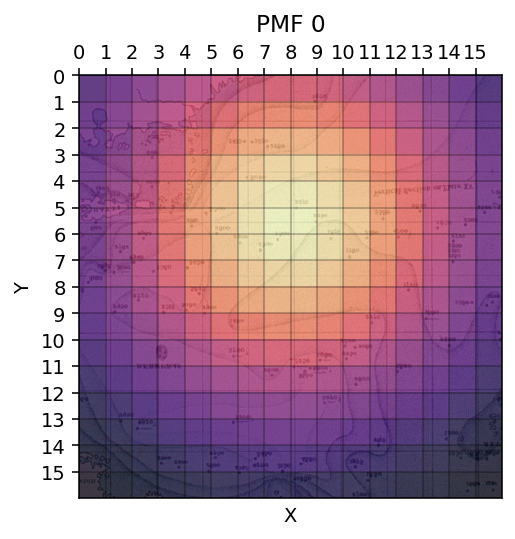

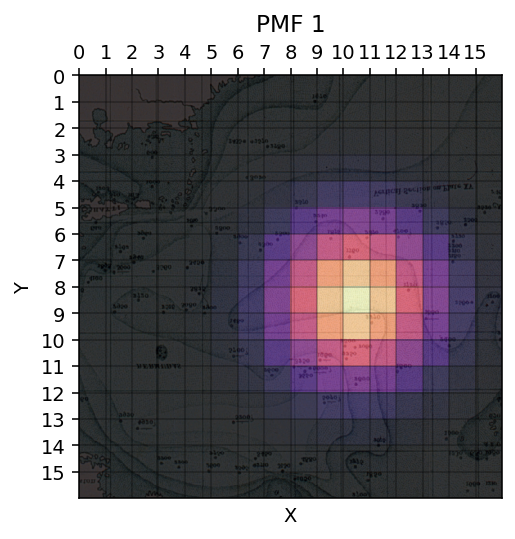

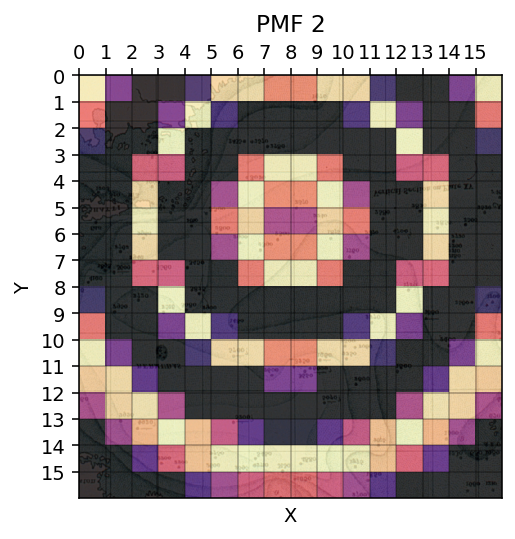

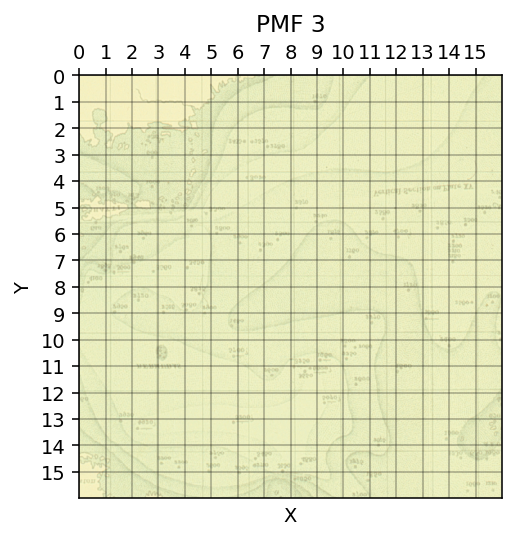

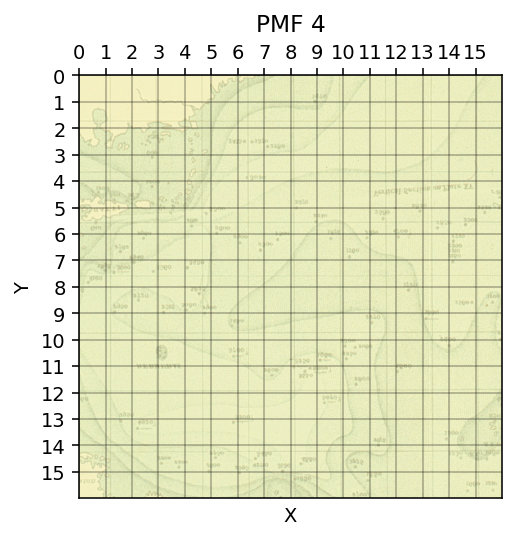

In [40]:
# Show each of the PMFs.
for i, pmf in enumerate(proposed_pmfs):
    show_pmf(pmf, title=f"PMF {i}")

In [41]:
# YOUR CODE HERE
valid_pmfs = []

for pmf in proposed_pmfs:
    # Each should be in the interval [0, 1].
    if np.any((pmf < 0) | (pmf > 1)):
        continue
    
    # The sum of probabilities equals 1. (Actually, it may be better to allow some floating point errors here. The sum of "submarine_pmf" can be less than 1. Anyway, it does not affect the final result for this question.)
    if np.sum(pmf) != 1:
        continue

    valid_pmfs.append(pmf)

In [42]:
with tick.marks(3):
    check_hash(valid_pmfs, ((2, 16, 16), 511.54549199055594))

---

## Sampling
We can use sampling to simulate where the submarine might lie on the sea floor. Write a function `sample_submarine(n)` which will randomly sample submarine locations according to `submarine_pmf`, returning a `nx2` array of sampled locations. Hint: there are 256 possible grid squares.

Note: your code may pass these tests but be incorrect; this will become apparent when you attempt the "reconstruct the PMF" part below.

In [43]:
# YOUR CODE HERE
def sample_submarine(n, pmf = submarine_pmf):
    '''
    Randomly sample submarine locations according to the PMF.

    Parameters
    ----------
    n : the number of sampled locations
    pmf : a PMF for reference

    Returns
    -------
    sample_locs : a N * 2 array of sampled locations
    '''

    cmf = np.cumsum(pmf)  # Get the cumulative mass function.
    samples = np.random.uniform(0, 1, n)  # Generate N random variables between 0 (included) and 1 (excluded).
    sample_squares = np.digitize(samples, cmf)  # Get the index of square that each sample belongs.
    sample_locs = np.zeros((n, 2), dtype = int)

    # Convert the index of square to a location.
    for index in range(n):
        sample_locs[index, 0] = int(sample_squares[index] / 16)
        sample_locs[index, 1] = sample_squares[index] % 16
    
    return sample_locs

# An example of how to call your sample_submarine function.
sample_submarine(100)

array([[ 7,  3],
       [10,  6],
       [ 0, 12],
       [ 8,  5],
       [ 4,  9],
       [ 5,  5],
       [ 5,  5],
       [ 5,  7],
       [14,  9],
       [11,  4],
       [13,  1],
       [ 7,  3],
       [14, 10],
       [10,  6],
       [ 5,  0],
       [ 3, 10],
       [11,  5],
       [11,  3],
       [ 6,  7],
       [ 7,  5],
       [ 9,  5],
       [ 4,  3],
       [13,  9],
       [ 7,  6],
       [12,  9],
       [13,  1],
       [ 0, 11],
       [12,  1],
       [ 3,  4],
       [ 4,  7],
       [ 8,  1],
       [11,  2],
       [11,  1],
       [ 9,  7],
       [ 7,  4],
       [ 8,  7],
       [10,  7],
       [ 9,  8],
       [ 1, 12],
       [ 6,  6],
       [ 9, 15],
       [ 6,  4],
       [ 8,  6],
       [ 2,  9],
       [ 6,  5],
       [ 3,  5],
       [ 6, 10],
       [ 9, 10],
       [ 4,  6],
       [ 9,  7],
       [11,  3],
       [ 3,  9],
       [ 8,  3],
       [ 6,  6],
       [ 6,  6],
       [ 5,  3],
       [15,  4],
       [ 8,  7],
       [12,  5

In [44]:
with tick.marks(3):    
    for n in [2, 4, 10, 1000, 5000]:
        samples =  sample_submarine(n)
        assert samples.shape == (n,2)
        assert np.sum(samples - np.floor(samples)) == 0.0
        mean = np.mean(samples, axis=0)
        sem = np.std(samples, axis=0)/np.sqrt(n)    
        assert np.all((mean-sem < [7.93, 5.67]) | ([7.93, 5.67] < mean+sem))

---

### Part 1.6 Reconstruct the PMF

From our samples (more realistically samples would be coming from an other source), we can reconstruct an approximation of the PMF. Write a function `reconstruct_pmf(samples)` that will reconstruct the PMF using the empirical distribution from a set of samples and return the reconstructed PMF as a 16x16 matrix. 


In [45]:
# YOUR CODE HERE
def reconstruct_pmf(samples):
    '''
    Reconstruct the PMF using the empirical distribution.

    Parameters
    ----------
    samples : a set of samples for the empirical distribution

    Returns
    -------
    pmf_est : an approximation of the PMF
    '''

    unique, counts = np.unique(samples, axis = 0, return_counts = True)  # Count the appearnce of a location. 
    pmf_est = np.zeros((16, 16))

    for index, loc in enumerate(unique):
        pmf_est[loc[0], loc[1]] = counts[index]

    return pmf_est / len(samples)  # Compute the empirical distribution.

<ipython-input-46-7a9741f3ddc0>:2: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.where((b<1e-10)|(a<1e-10), 0.0, a * np.log(a/b)))
<ipython-input-46-7a9741f3ddc0>:2: RuntimeWarning: invalid value encountered in multiply
  return np.sum(np.where((b<1e-10)|(a<1e-10), 0.0, a * np.log(a/b)))


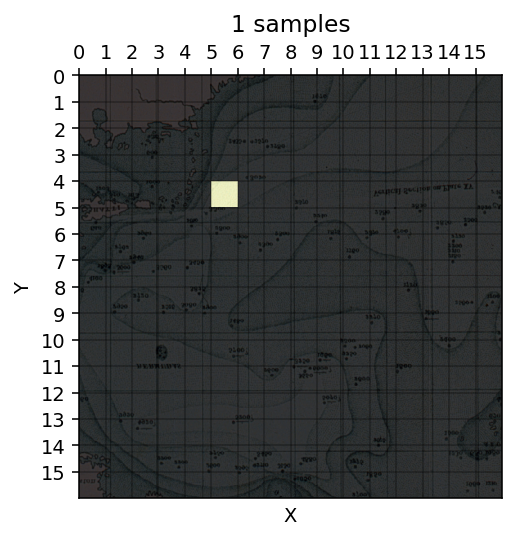

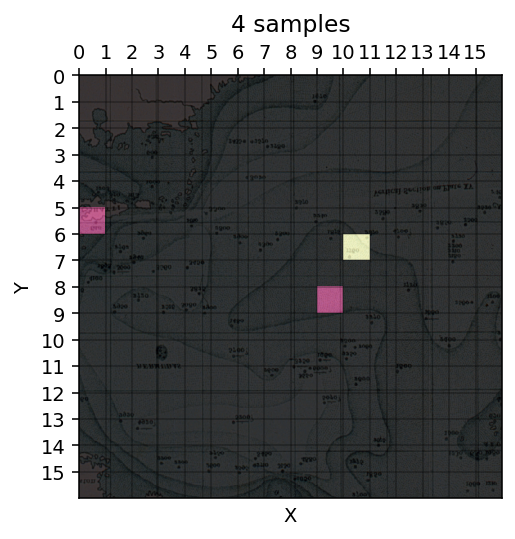

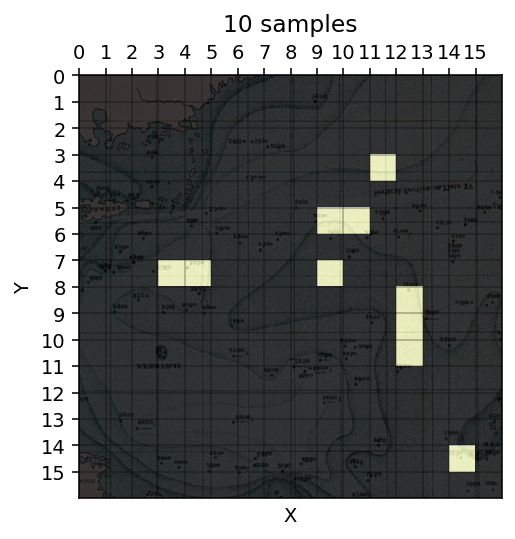

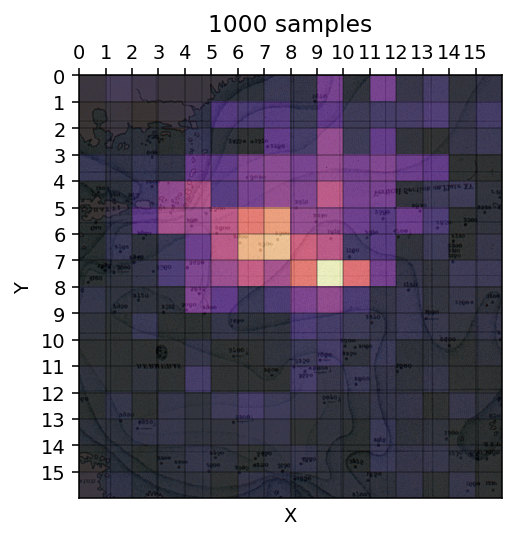

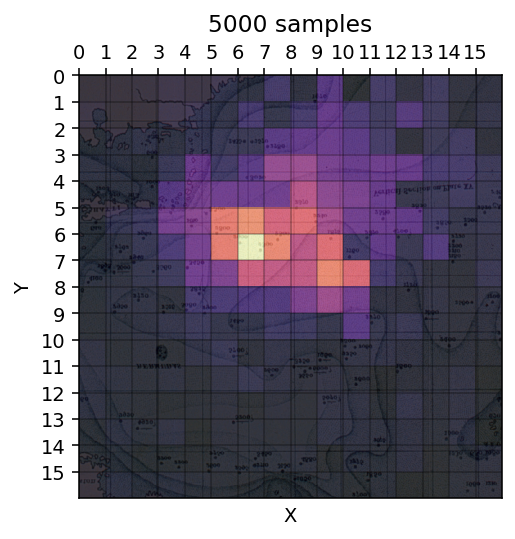

In [46]:
def kl(a, b):
    return np.sum(np.where((b<1e-10)|(a<1e-10), 0.0, a * np.log(a/b)))

with tick.marks(2):    
    kls = [4.0, 3.5, 2.5, 0.1, 0.02]
    for i,n in enumerate([1, 4, 10, 1000, 5000]):        
        approx_pmf =  reconstruct_pmf(sample_submarine(n))
        assert approx_pmf.shape == submarine_pmf.shape
        assert check_scalar(np.sum(approx_pmf), "0xb44c37ea")     
        assert np.max(approx_pmf)<=1.0
        assert np.min(approx_pmf)>=0.0
        kl_div = abs(kls[i] - kl(approx_pmf, submarine_pmf))/kls[i]        
        assert kl_div < 1.0             
        sample = reconstruct_pmf(sample_submarine(n))
        show_pmf(sample, f"{n} samples")             

---

### Part 1.7 Log likelihood
Various theoretical models of oceanographic features have been used to simulate what happened to the submarine. 

* crater
* zeeman_shift
* oblov_1
* minority
* inviscid

Each of these models produces a collection of simulated submarine locations as a result.

`submarine_samples` provides a dictionary with samples from various named submarine position generating functions. Compute the *log*-likelihood of each sequence $\log \mathcal{L}(x_1, x_2,\dots)$ under the model defined by the PMF `submarine_pmf`. 
* `sequence_lliks`  a dictionary that maps the names to the log-likelihood.
* `most_likely_sequence` the name of the sequence is most likely to be compatible with this model.


In [47]:
print(submarine_samples.keys())

dict_keys(['crater', 'zeeman_shift', 'oblov_1', 'minority', 'inviscid'])


In [48]:
# YOUR CODE HERE
def llik(seq) -> float:
    '''
    Compute the log-likelihood of a collection of simulated submarine locations under the specified PMF model.

    Parameters
    ----------
    seq : a collection of simulated submarine locations

    Returns
    -------
    result : the log-likelihood of the sequence
    '''

    result = 0

    for loc in seq:
        result += np.log(submarine_pmf[loc[0], loc[1]])
    
    return result

sequence_lliks = {}

for key in submarine_samples.keys():
    sequence_lliks[key] = llik(submarine_samples[key])

most_likely_sequence = max(sequence_lliks, key = sequence_lliks.get)  # The sequence with the maximum log-likelihood can be the most likely.

In [49]:
hashes = {
    "crater": "0x7315af59",
    "zeeman_shift": "0x73114def",
    "oblov_1": "0xeb8d319c",
    "minority": "0xf8150629",
    "inviscid": "0xfab3048e",
}

with tick.marks(3):
    for key in submarine_samples.keys():
        print(key, sequence_lliks[key])
        assert check_scalar(sequence_lliks[key], hashes[key])

crater -674.5851127039633
zeeman_shift -495.1125901495219
oblov_1 -603.5944982683787
minority -606.1277196511766
inviscid -553.3337126608025


In [50]:
# Hidden test checking the string most_likely_sequence [1 mark]

---

### Part 1.8 Bayes' rule

The function `search_submarine(x,y)` returns the **likelihood** for the submarine's location, given an `x` and `y` coordinate to search at based on sonar returns from a search ship. It returns this as a 16x16 matrix.

Using `submarine_pmf` as a prior, compute the posterior PMF using the result of `search_submarine(10, 7)` as likelihood. Store the result in `submarine_posterior`.

In [51]:
# YOUR CODE HERE
p = search_submarine(10, 7) * submarine_pmf  # P(D|H)P(H) = likelihood * prior
submarine_posterior = p / np.sum(p)  # P(H|D) = p / evidence = p / P(D) = p / SUM(p) (Bayes' rule + law of total probability)

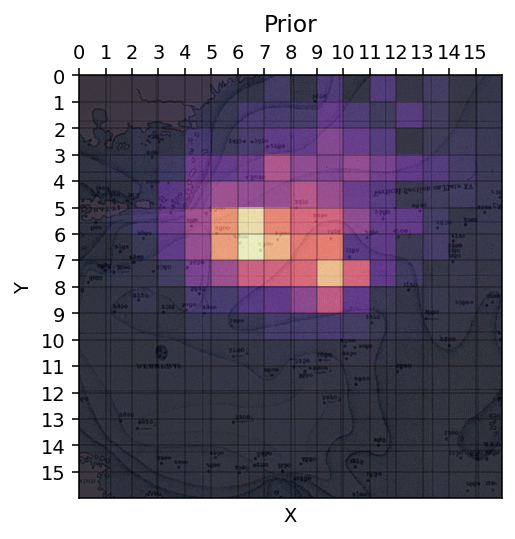

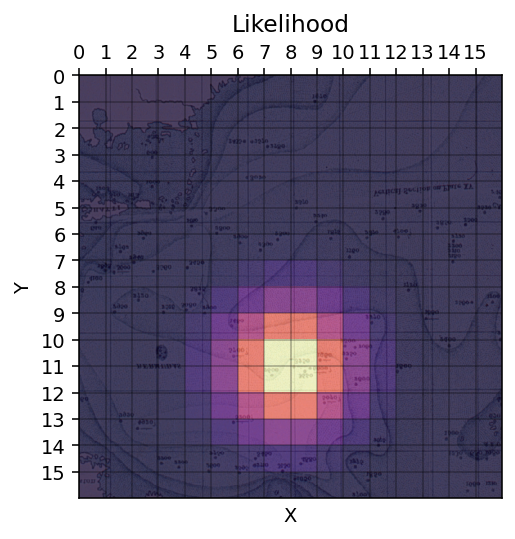

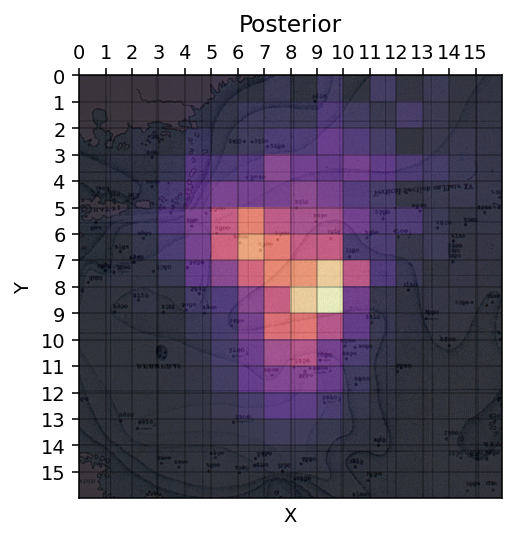

In [52]:
show_pmf(submarine_pmf, 'Prior')
show_pmf(search_submarine(10,7), 'Likelihood')
show_pmf(submarine_posterior, 'Posterior')
with tick.marks(5):
    assert check_hash(submarine_posterior, ((16, 16), 129.2249265521699))

---

### Part 1.9 Sequential searching 
Compute the posterior distribution after searching the each of squares y=8, x=0..15 (i.e. testing *each* of these 16 squares in turn, and combining *all* of the evidence into a posterior), storing the posteriors as a list, *starting with the prior* and ending with the posterior after observing y=8, x=15. You should have a 17 element list of 16x16 matrices. Store this as `search_strip_posterior`


In [53]:
# YOUR CODE HERE
search_strip_posterior = [submarine_pmf]

for index in range(16):
    p = search_submarine(index, 8) * search_strip_posterior[index] # Loop through the list taking the last posterior and feeding it as the prior.
    search_strip_posterior.append(p / np.sum(p))

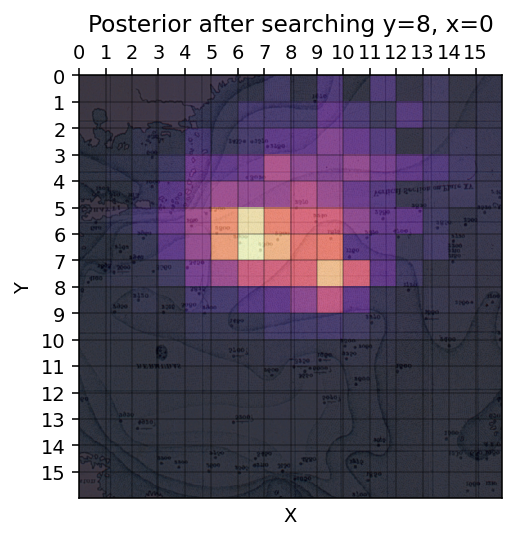

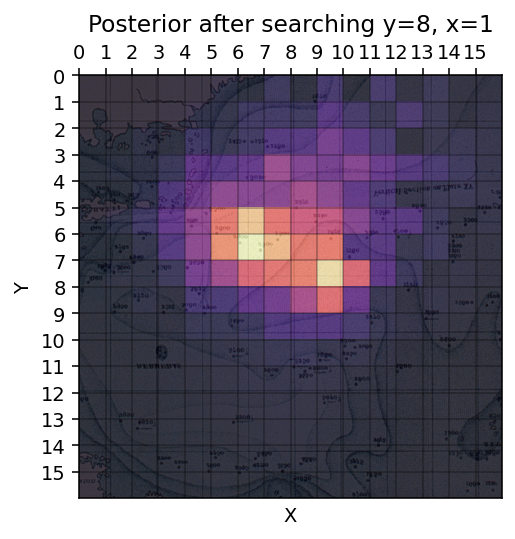

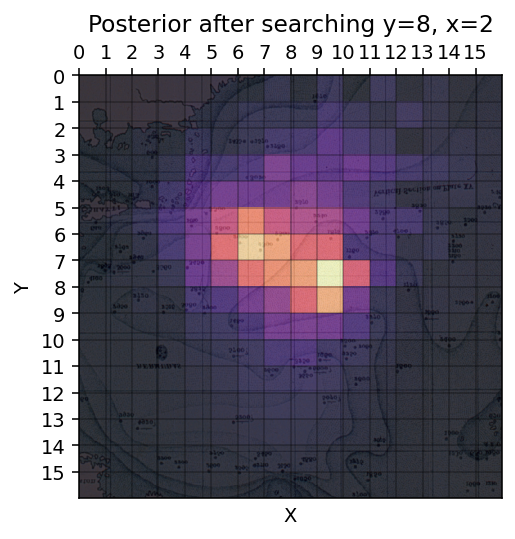

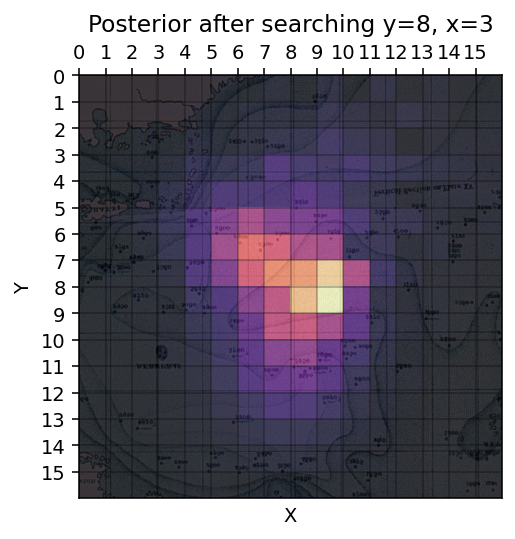

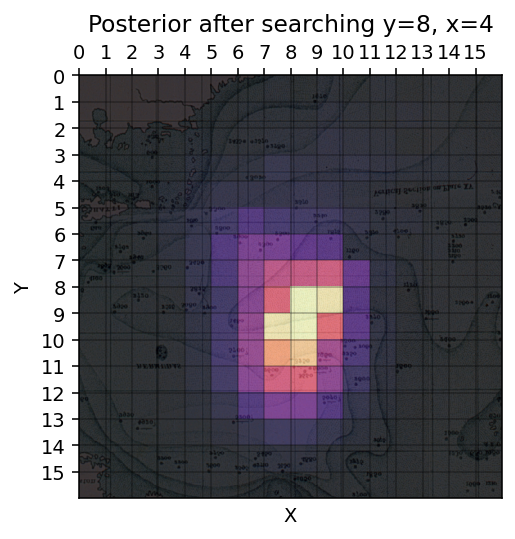

...

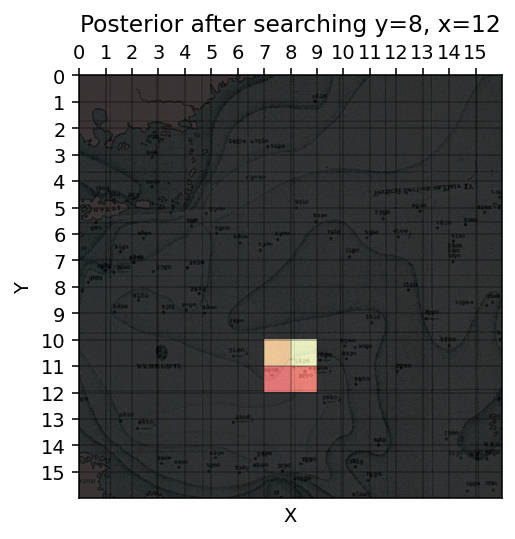

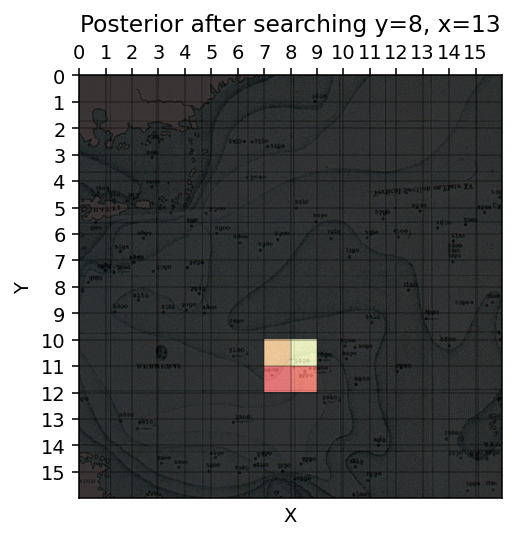

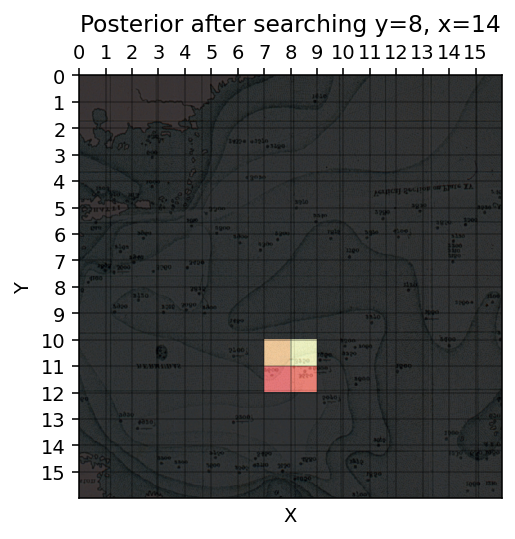

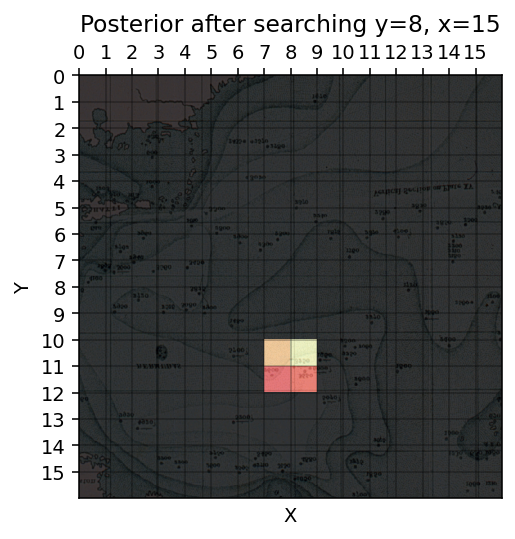

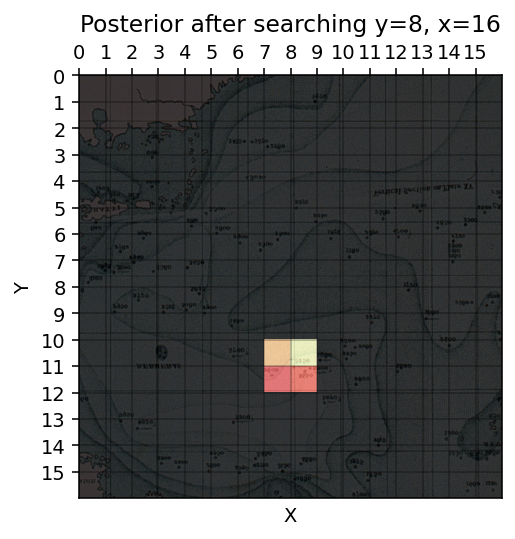

In [54]:
# Sanity check that the size is ok [0 marks]
with tick.marks(0):
    assert(len(search_strip_posterior)==17)
    assert(search_strip_posterior[0].shape==(16, 16)) # only check one of the 17 matricies

# Show the 17 individual posteriors
for i, p in enumerate(search_strip_posterior):
    show_pmf(p, f'Posterior after searching y=8, x={i}')

In [55]:
# Hidden test checking search_strip_posterior [6 marks ]

---

---


---

---

## Part 2. Hunt the submarine: continuous version
The simple discrete grid model is easy to do computations with but not a very realistic model. A better world model is that locations are *continuous* in nature; for example points specified as longitude and latitude. To work with this model probabilistically, we need to use (multivariate, i.e. vector) **probability density functions** which map coordinates to *density*, not probability.



### Multivariate normal distribution
The PDF for the multivariate Normal distribution is defined as follows (for column vectors):

$$f_{{X}}(\vec{x})=\frac{1}{\sqrt{(2\pi)^d|\boldsymbol\Sigma|}}\operatorname{exp}\left( -\frac{1}{2} (\vec{x}-\boldsymbol\mu)^\top \boldsymbol\Sigma^{-1} (\vec{x}-\boldsymbol\mu)   \right)$$
where $\boldsymbol\mu$ is the mean (vector), $d$ is the dimension of $\vec{x}$ and $\boldsymbol\Sigma$ is the $dxd$ covariance matrix.

### Continuous distributions
A continuous random variable can be represented as a class that has parameters and that provides two functions:

* `llik` the log-likelihood of an observation
* `sample` that returns a sample from a distribution

The multivariate normal PDF is implemented below using standard `scipy` implementations along with useful methods for drawing the density for debugging.

In [56]:
import scipy.stats
from jhwutils.ellipse import _cov_ellipse

class MultivariateNormal:
    
    def __init__(self, mu, sigma):
        # use the existing implementation in scipy.stats
        self.mu = mu
        self.sigma = sigma
        self.distribution = scipy.stats.multivariate_normal(self.mu, self.sigma)
    
    # log-likelihood of one observation
    def llik(self, x):
        return self.distribution.logpdf(x)
    
    # n random samples
    def sample(self, n):
        return self.distribution.rvs(n)        
        
    # render the distribution pdf as if it were a PMF
    def draw(self):            
        span = np.linspace(0,16,160)
        grid = np.array(np.meshgrid(span, span)).reshape(2, -1).T        
        pdf = self.distribution.pdf(grid)        
        show_pmf(pdf.reshape(160,160).T)                        

---

### Part 2.1
Instantiate a multivariate Normal distribution using the `MultivariateNormal` class defined above. Store it in `x`. E.g. `x = MultivariateNormal(mu=m, sigma=S)`

The PDF should have mean with coordinates (7,8), variance of one along both the latitude and longitude direction, and a covariance of 0.8.


In [57]:
# YOUR CODE HERE
x = MultivariateNormal([7, 8], [[1, 0.8], [0.8, 1]])

In [58]:
# Autograded [2 marks]
with tick.marks(2):
    assert check_hash(x.mu, ((2,), 53.5))
    assert check_hash(x.sigma, ((2,2), 12.700000000000001))

**Try varying these parameters (in a new unassessed cell) and viewing the resulting distributions to understand what effect they have:**

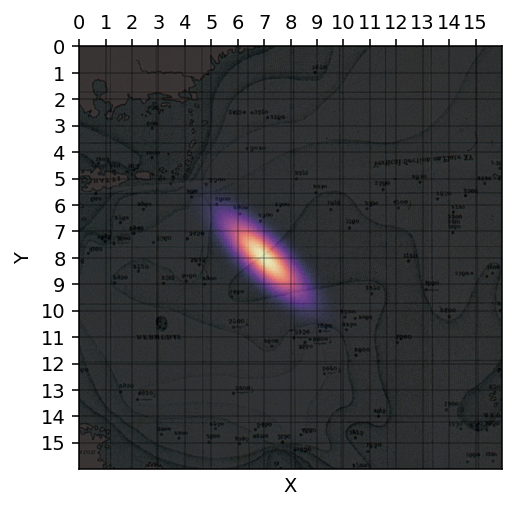

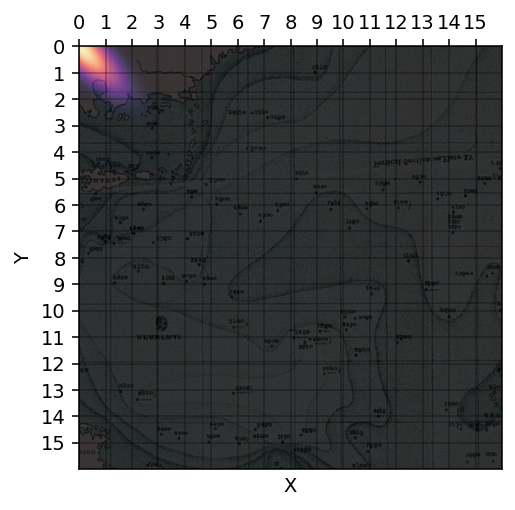

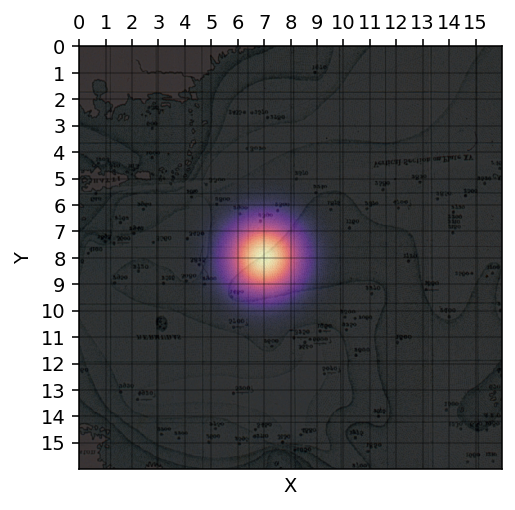

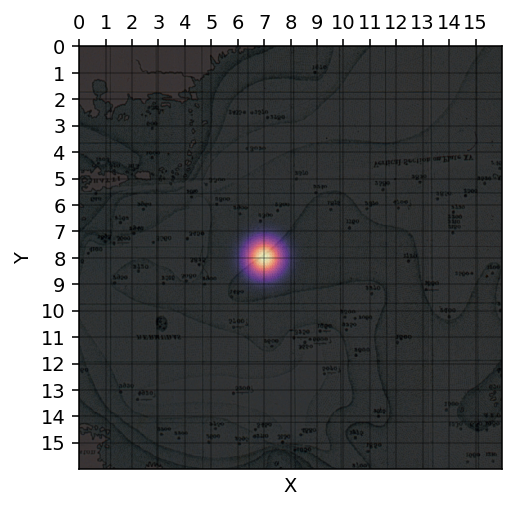

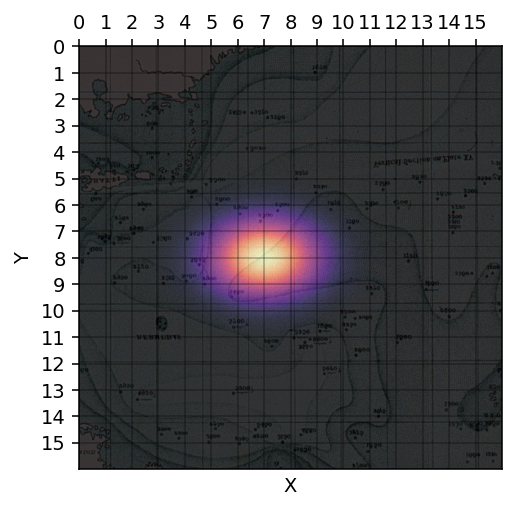

In [59]:
# Test purposes only: try different mean vectors (centre) and covariances (spreads).
x.draw()  # Skewed.

MultivariateNormal([0, 0], [[1, 0.8], [0.8, 1]]).draw()  # Off-centre.
MultivariateNormal([7, 8], [[1, 0], [0, 1]]).draw()  # Unit.
MultivariateNormal([7, 8], [[0.25, 0], [0, 0.25]]).draw()  # Tighter.
MultivariateNormal([7, 8], [[2, 0], [0, 1]]).draw()  # Stretched.

---

### Part 2.2 Fitting with direct computation

There are a collection of *observed* potential locations for the submarine from a search ship in `submarine_observations`. The problem is to fit the parameters of a PDF given these observations.

Recall that the **arithmetic mean** is sum of sample values $\vec{x}_1, \vec{x}_2, \dots, \vec{x}_n$ divided by the number of values:
$$\hat{\boldsymbol\mu} = \frac{1}{n} \sum_{i=1}^n \vec{x}_i$$

The empirical covariance is computed by:

$${\boldsymbol{\hat \Sigma }} = \frac{1}{{n - 1}}\sum\limits_{i = 1}^n {{{\left( {{{\mathbf{x}}_i} - {\boldsymbol{\hat \mu }}} \right)}^T}\left( {{{\mathbf{x}}_i} - {\boldsymbol{\hat \mu }}} \right)} $$

Under the assumption that a reasonable model for the submarine location is a multivariate normal:

* directly estimate the parameters for a `MultivariateNormal` using standard numpy functions (which we have used in previous labs and several lectures) and store the result in `normal_mu_hat` and `normal_sigma_hat`.
* `llik_normal` the log-likelihood of the *entire* set of observations under this model (i.e. with these parameters)
* `samples_normal` 250 samples drawn from the multivariate normal model with these parameters
* `llik_misfit` how much smaller the log-likelihood of observations is compared to the samples *generated under the model* (i.e. `samples_normal`). This should be a negative number.

In [60]:
submarine_observations = np.loadtxt('data/submarine2021.txt')

In [61]:
# Set a seed - DO NOT MODIFY
np.random.seed(2019)
############################

# YOUR CODE HERE
normal_mu_hat = np.mean(submarine_observations, axis = 0)  # Compute the arithmetic mean.
normal_sigma_hat = np.cov(submarine_observations.T)  # Compute the empirical covariance matrix.
# NOTE: the following commented lines are the way to compute the empirical covariance matrix directly based on the given formula.
# component = submarine_observations - normal_mu_hat  # sample x - hat μ
# normal_sigma_hat = component.T @ component / (len(submarine_observations) - 1)

x = MultivariateNormal(normal_mu_hat, normal_sigma_hat)
llik_normal = np.sum(x.llik(submarine_observations))
samples_normal = x.sample(250)
llik_misfit = np.sum(x.llik(samples_normal)) - llik_normal

Text(0.5, 1.0, 'Log-likelihood = -924.87')

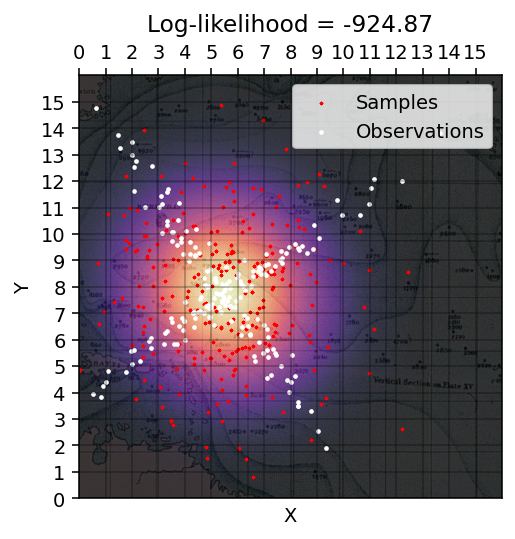

In [62]:
x = MultivariateNormal(normal_mu_hat, normal_sigma_hat)

x.draw()
ax = plt.gca()
ax.scatter(samples_normal[:,0], samples_normal[:,1], c='r', marker='x', s=1, label="Samples")
ax.scatter(submarine_observations[:,0], submarine_observations[:,1], marker='o', color='w', s=2, label="Observations")
ax.set_xlim(0,16)
ax.set_ylim(0,16)
ax.legend()
ax.set_title(f"Log-likelihood = {llik_normal:.2f}")

In [63]:
with tick.marks(2):
    assert check_hash(normal_mu_hat, ((2,), 48.740483070253134))
    assert check_hash(normal_sigma_hat, ((2,2), 43.07270996803091))    

In [64]:
with tick.marks(2):
    assert samples_normal.shape == (250, 2)
    assert np.all(np.std(samples_normal, axis=0)>0.5)
    assert np.all(np.mean(samples_normal, axis=0) - np.array([13, 9]) < 4.0 * (np.std(samples_normal, axis=0)/np.sqrt(250)))  

In [65]:
# Hidden test checking the scalar llik_normal [3 marks]

In [66]:
# Hidden test checking the scalar llik_misfit [4 marks]

---

### Part 2.3: A cross search pattern

Scientists argue that a better model for the location of the submarine is a cross-shaped density that reflects two possible ocean currents in the Atlantic and is also easier to search by ship. The scientists have written a probabilistic model which gives the density of a specialised "cross distribution". This is a non-standard distribution that has four parameters: `ctr`, `span`, `leg` and `angle`.

<img src="imgs/ship_cross.png" width="50%">


In [67]:
class CrossDistribution:
    def __init__(self, ctr, span, leg, angle):
        self.ctr = ctr
        leg = 1.0 + np.log(leg + 1.0)
        s, c = np.sin(np.radians(angle)), np.cos(np.radians(angle))
        r1 = np.array([[s / leg, c * leg], [c / leg, -s * leg]])
        r2 = np.array([[-c / leg, s * leg], [s / leg, c * leg]])
        scale = np.eye(2) * np.sqrt(span)
        self.arm1 = scipy.stats.multivariate_normal(self.ctr, r1 @ scale @ scale @ r1.T)
        self.arm2 = scipy.stats.multivariate_normal(self.ctr, r2 @ scale @ scale @ r2.T)

    # log-likelihood of one observation
    def llik(self, x):
        return np.log((self.arm1.pdf(x) + self.arm2.pdf(x)) / 2.0)

    # n random samples
    def sample(self, n):
        a1_samples = self.arm1.rvs(n)
        a2_samples = self.arm2.rvs(n)
        return np.where(np.random.uniform(0, 1, n) < 0.5, a1_samples.T, a2_samples.T).T

    # render the distribution pdf as if it were a PMF
    def draw(self):
        span = np.linspace(0, 16, 160)
        grid = np.array(np.meshgrid(span, span)).reshape(2, -1).T

        pdf = 0.5 * self.arm1.pdf(grid) + 0.5 * self.arm2.pdf(grid)
        show_pmf(pdf.reshape(160, 160).T)

**Try varying these parameters and viewing the resulting distributions to understand what effect they have:**

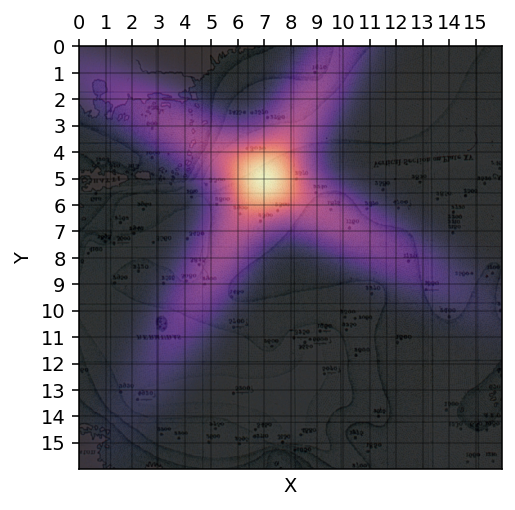

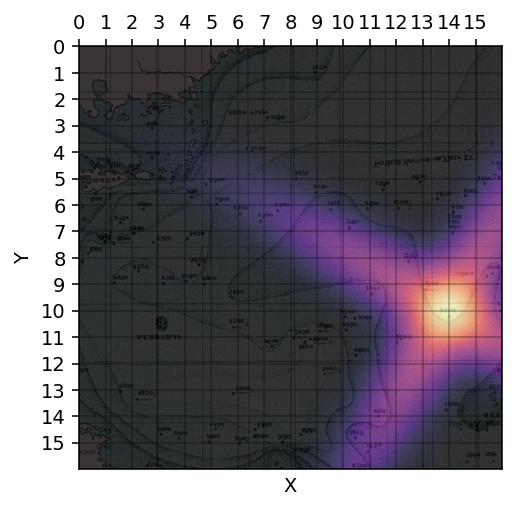

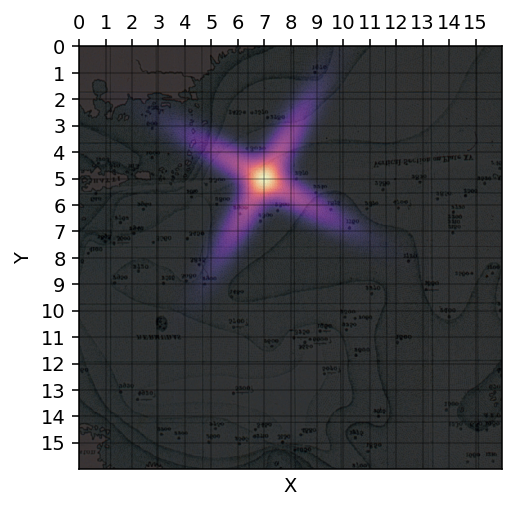

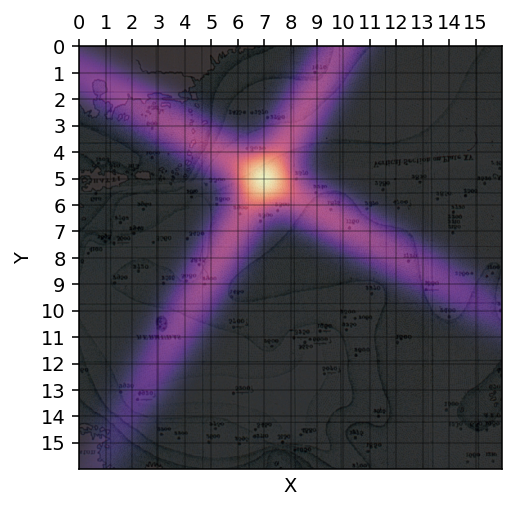

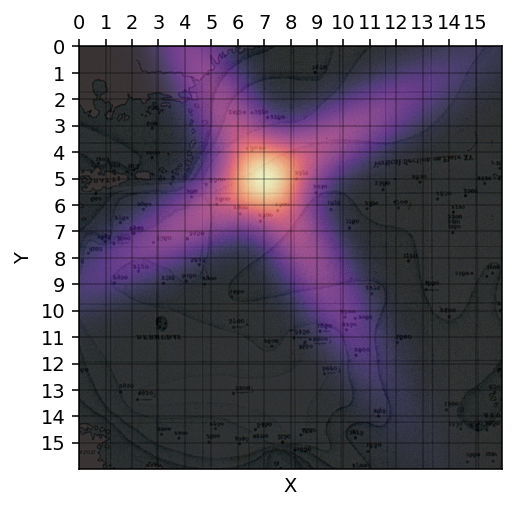

In [68]:
# Test purposes only: try different parameters.
CrossDistribution(ctr = (7, 5), span = 5.1, leg = 3, angle = -30).draw()  # For comparison.
CrossDistribution(ctr = (14, 10), span = 5.1, leg = 3, angle = -30).draw()  # Understand the effect of "ctr" (centre).
CrossDistribution(ctr = (7, 5), span = 1, leg = 3, angle = -30).draw()  # Understand the effect of "span".
CrossDistribution(ctr = (7, 5), span = 5.1, leg = 9, angle = -30).draw()  # Understand the effect of "leg".
CrossDistribution(ctr = (7, 5), span = 5.1, leg = 3, angle = -60).draw()  # Understand the effect of "angle".

---

### Part 2.4 Expectation

We would like to be able to compute the expected location (and search time/distance) for this model. But we can't do a simple operation with a PDF like we could with the PMF model. Instead, we can use sampling methods to approximate the expectation $\hat{\mathbb{E}}[f(X)]$.

Using the same formula `time = distance**2 + 4*distance + 10` as in Part 1, use the Monte Carlo approximation to the expectation, with 1000 samples, to compute:

* `cross_expected_location` the expected location  (a 2D vector)
* `cross_expected_distance` expected L2 distance from the fixed station at (14,2) 
* `cross_expected_time`  expected search time in hours from this station.

with a cross distribution having the parameters:
    
        ctr = (6,10)
        span = 0.5
        leg = 8.0
        angle = 45.0


In [69]:
# Seed
np.random.seed(2019) # DO NOT CHANGE
##########################

# YOUR CODE HERE
cf = CrossDistribution(ctr = (6, 10), span = 0.5, leg = 8, angle = 45)
loc_samples = cf.sample(1000)
cross_expected_location = np.mean(loc_samples, axis = 0)
distances = np.linalg.norm(loc_samples - np.array([14, 2]), axis = 1)
cross_expected_distance = np.mean(distances)
cross_expected_time = np.mean(distances ** 2 + 4 * distances + 10)

In [70]:
print(cross_expected_location)
print(cross_expected_distance)
print(cross_expected_time)

[6.0738557  9.97957694]
11.350333370588368
186.96545279759152


In [71]:
with tick.marks(1):
    assert check_scalar(np.sum(cross_expected_location), '0x36c7c001', tol=1)

In [72]:
with tick.marks(2):
    assert check_scalar(cross_expected_distance, '0x84e71c11', tol=1)

In [73]:
# Hidden test cross_expected_time [5]

---

## Part 2.5 Estimating parameters by optimising the likelihood 
*Note* this is the difficult and challenging part of this lab.

There is no direct form to compute the parameters  `ctr`, `span`, `leg` and `angle` from `submarine_observations` in the way we could for the simple normal distribution. 

We can instead exploit the idea of maximum likelihood which aims to make inferences about the parameters that where most likely to generate the observations. Recall that we have the likelihood of a single observation under the model

$$\mathcal L(\theta;\vec{x}) = f_X(\vec{x};\theta)$$

where $\theta$ are the parameters `ctr`, `span`, `leg` and `angle` and $\vec{x}$ is one of the 2d observations in `submarine_observations`.

If we assume our observations are independent and identically distributed, we can define an **objective function** for all observations, namely the product of the individual likelihood terms

$$\mathcal{L}(\theta ;{\{ {x_i}\} ^{i = 1:n}}) = -\prod\limits_{i = 1}^n {\mathcal{L}(\theta ;{x_i})} $$

If we take the log (perhaps to achieve greater numerical stability) and futher more take the negative value (as maximiseing the likelihood, is equivalent to minimiseing the negative likelihood), we get the following optimisation problem:

$$\theta^* = \argmin_\theta L(\theta)$$
$$L(\theta) = -\log \mathcal{L}(\theta | x_1, \dots, x_n) = -\sum_i \log f_X(x_i;\theta) , $$

This is *very* similar to the approximation objective function we saw in the optimisation part of this course $\|f(\vec{x};\theta)-y\|$, but we have $y=0$ and we only have a scalar output from $f$ so the norm is unnecessary. We already know how to solve this kind of problem; just optimise. This is called **maximum likelihood estimation** and is a general technique for determining parameters of a distribution which we don't know given some observations. It will find the **best** setting of parameters that would explain how the observations came to be.


Using your own custom  **stochastic hill-climbing** (you can find code in the optimisation lab) and the idea of **maximum likelihood**, create a function `optimise_llik` to find the best parameter settings `theta= [ctr_x, ctr_y, span, leg, angle]` given the observations in `submarine_observations`. The signature of the function is given in the cell below.

In the specific setting we also know that; 

* `ctr` must be a vector in [0,0] to [16,16], 
* `span` must be a scalar in range 0.0 to 20.0
* `leg` must be a scalar from 0.0 to 10.0
* `angle` must be a scalar from -45.0 to 0.0 (***Note***: **minus** 45 degrees to 0 degrees!)

which must be accounted for in your optimisation routine to find a best-fit estimate for `theta`. **Solutions not obeying the constraints will result in zero marks.**

**Note: you would likely need to implement a number of helper functions.**

You should be able to find a good fit within 10,000 iterations (max 15000). You will need to modify the stochastic hill climbing code to enforce the above constraints and ensure that you algorithm converges to a sensible solution by inspecting the plots and parameters. You may need to change the random seed and various parameters to arrive at a sensible solution.

**Note: We will test your solution on multiple instances so you cannot hardcode the solution. We will NOT accept solutions using any in-built optimization functions.**


In [74]:
# YOUR CODE HERE
def optimise_llik(observations, pdf, iters):
    '''
    Find the best parameter settings.

    Parameters
    ----------
    observations: a numpy array with the observations (e.g submarine_observations)
    pdf: the PDF (e.g. CrossDistribution)
    iters: number of iterations   
    
    Returns
    -------
    theta : the best parameter settings
    '''

    best_loss = np.inf

    # Allow 1 more iteration to initialise the theta and loss.
    for i in range(iters + 1):
        theta = guess() if i == 0 else neighbour(best_theta)
        
        if 0 <= theta[0] <= 16 and 0 <= theta[1] <= 16 and 0 <= theta[2] <= 20 and 0 <= theta[3] <= 10 and -45 <= theta[4] <= 0:
            cf = pdf((theta[0], theta[1]), theta[2], theta[3], theta[4])
            loss = -np.sum(cf.llik(observations))
                
            if best_loss >= loss:
                best_theta = theta
                best_loss = loss

    return best_theta

def guess():
    '''
    Initially guess theta.

    Returns
    -------
    theta : the initial parameter settings
    '''

    ctr = np.random.uniform(0, np.nextafter(16, 17), (2,))
    span = np.random.uniform(0, np.nextafter(20, 21))
    leg = np.random.uniform(0, np.nextafter(10, 11))
    angle = np.random.uniform(-45, np.nextafter(0, 1))
    return np.array([ctr[0], ctr[1], span, leg, angle])

def neighbour(x):
    '''
    Adjust theta a bit.

    Parameters
    ----------
    x : the parameter settings
    
    Returns
    -------
    theta : the parameter settings after adjustment
    '''

    return x + np.random.normal(0, 0.25, x.shape)

Run the implemented optimisation function on the `submarine_observations` using the `CrossDistribution`. You can change the random seed and number of iterations (**max 15000 iterations**!).

In [75]:
# YOUR CODE HERE
my_random_seed = 1000
iters = 10000

In [76]:
np.random.seed(my_random_seed) # you are free to change this if helpful in the previous cell
theta = optimise_llik(observations=submarine_observations, pdf=CrossDistribution, iters=iters)
print("Estimated parameters:", theta)

Estimated parameters: [  5.54289407   7.68594243   1.00618674   9.47344819 -35.1057986 ]


Let us plot the solution. **Hint**: While you don't know the true parameters you can do various inspections/tests to ensure that your solution is sensible before submitting.  

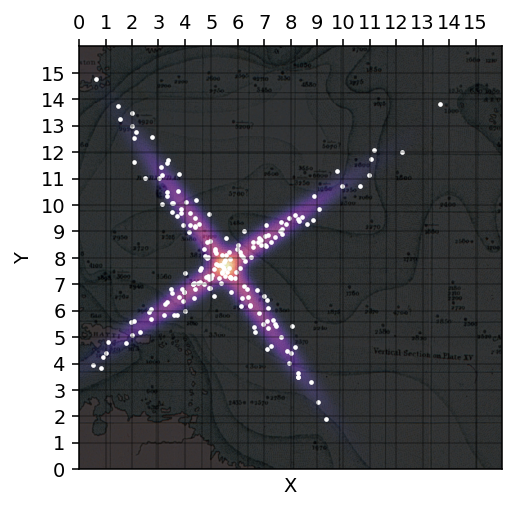

In [77]:
cf = CrossDistribution(ctr=(theta[0],theta[1]), span=theta[2], leg=theta[3], angle=theta[4])
cf.draw()
ax = plt.gca()
ax.scatter(submarine_observations[:,0], submarine_observations[:,1], marker='o', color='w', s=2, label="Observations")
ax.set_xlim(0,16)
ax.set_ylim(0,16)
fig_2_5 = plt.gcf() # do not modify

In [78]:
# Hidden auto graded [5 marks]... if your optimiser gets you in the vicinity of the true parameters 

In [79]:
# Hidden auto graded [8 marks]... if your optimiser gets you very close to the true parameters

In [80]:
# A hidden cell for use by markers


---


# Submission on Moodle


We will generate the **one** pdf file you'll need to submit along with the notebook:

*Note*: you do not need to worry about the formatting etc (that's predetermined)


In [81]:
## Report generation - YOU MUST YOU RUN THIS CELL !
#
# Ignore warnings regarding fonts
#
from matplotlib.backends.backend_pdf import PdfPages

# Declaration of originality with system info
try:
    f = open('uofg_declaration_of_originality.txt','r')
    uofg_declaration_of_originality = f.read()
except: 
    uofg_declaration_of_originality = "uofg_declaration_of_originality not present in cwd"

try:
    student_id.lower()
except: 
    student_id="NORESPONSE"
try:
    student_typewritten_signature.lower()
except: 
    student_typewritten_signature="NORESPONSE"

fn = ("idss_lab_03_probability_%s_declaration.pdf" % (student_id.lower()))
fig_dec = plt.figure(figsize=(10, 12)) 
fig_dec.text(0.1,0.1,("%s\n\n Student Id %s\n\n Typewritten signature: %s\n\n UUID System: %s" % (uofg_declaration_of_originality,student_id, student_typewritten_signature, uuid_system)))
    
# Combined: 
fn = ("idss_lab_03_probability_%s_combined_v20202021a.pdf" % (student_id))
pp = PdfPages(fn)
pp.savefig(fig_2_5)
pp.savefig(fig_dec)
pp.close()

with tick.marks(0):  # have you generated the combined file...? you don't actually get any credit for this; just confirmation that the file has been generated
    assert(os.path.exists(fn))

<Figure size 1400x1680 with 0 Axes>

**You must (for full or partial marks) submit via Moodle:**

- this notebook (completed) after "Restart and rerun all":
    - `idss_lab_03_probability_v20202021a.ipynb`
    
- the combined pdf (autogenerated) containing the relevant figures and answers for the manual marking:
     - `idss_lab_03_probability_[YOUR STUDENT ID]_combined_v20202021a.pdf`)     


---

# Appendix: Marking Summary (and other metadata)
#### - make sure the notebook runs without errors (remove/resolve the `raise NotImplementedError()`) and "Restart and Rerun All" cells to get a correct indication of your marks.

In [82]:
print("Marks total : ","100")
print("Marks visible (with immediate feedback): ","55")
print("Marks hidden (without immediate feedback): ","45")
print("\nThe fraction below displays your performance on the autograded part of the lab that's visible with feedback (only valid after `Restart and Run all`:")
tick.summarise_marks() # 
print("- the autograded (and visible) marks account for at least 50% of the total lab assesment.")

Marks total :  100
Marks visible (with immediate feedback):  55
Marks hidden (without immediate feedback):  45

The fraction below displays your performance on the autograded part of the lab that's visible with feedback (only valid after `Restart and Run all`:


- the autograded (and visible) marks account for at least 50% of the total lab assesment.


---